<img src="Colab_Logo.jpg" alt="Google Colab" height="50" width="50" align="left">
This experiment has been performed on Google Colab. It is required to set-up dev. environment and mount the Google drive to Colab.

# <b>Part 2. Base Model Building using PyTorch-based Detectron2 - Traing Time
-----------------------------------------------------------------------------------------------------------------

## <b>1. Data Preparation

### 1) Set-up Basic Libraries

In [ ]:
# Import some common libraries
import os
import cv2
import json
import random
import itertools
import numpy as np
from matplotlib import pyplot as plt

# Setup detectron2 logger
import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()

# Import some common detectron2 utilities
from detectron2 import model_zoo
from detectron2.config import get_cfg
from detectron2.structures import BoxMode
from detectron2.data import MetadataCatalog
from detectron2.utils.visualizer import Visualizer
from detectron2.data import DatasetCatalog, MetadataCatalog
from detectron2.data.datasets import register_coco_instances
from detectron2.engine import DefaultPredictor, DefaultTrainer

# from google.colab.patches import cv2_imshow # for google colab

In [2]:
# Current directory
print(f"Current directory: {os.getcwd()}")
# ROOT_DIR = os.getcwd() + "/" # My Laptop
ROOT_DIR = os.getcwd() + "/gdrive/My Drive/Car_Damage/" # Google Colab
print(f"Colab root directory: {ROOT_DIR}")

# Set values - choose a json file and image folder for train/validation
STR_dataset_name_val        = "dataset_val_aug_nonoise" # json file: val_base.json
STR_dataset_name_coco_val   = "dataset_val_aug_coco_nonoise"

STR_json_name_train         = "train_aug_nonoise.json"
STR_json_name_val           = "val_base.json"
STR_json_name_val_coco      = "val_aug_coco_nonoise.json"

STR_img_folder_train        = "train_aug_nonoise" 
STR_img_folder_val          = "val_aug_nonoise"

STR_anno_path               = "dataset/annotations"
STR_json_path               = ROOT_DIR + STR_anno_path + "/"



Current directory: /content
Colab root directory: /content/gdrive/My Drive/Car_Damage/


### 2) Create and Register Dataset

In [ ]:
# Define training dataset dicts
def car_damage_dicts(img_dir):    
    if "train" in img_dir:
        json_file_name = STR_json_name_train
    else:
        json_file_name = STR_json_name_val
        
    json_file_dir = os.path.join(ROOT_DIR + STR_anno_path, json_file_name)

    with open(json_file_dir) as f:
        imgs_anns = json.load(f)

    dataset_dicts = []
    for _, v in imgs_anns.items():
        record = {}
        
        filename = os.path.join(img_dir, v["filename"])
        height, width = cv2.imread(filename).shape[:2]
        
        record["file_name"] = filename
        record["height"] = height
        record["width"] = width
      
        annos = v["regions"]
        objs = []
        
        # Added codes here to extract the class of damage
        classes = ["scratch", "dent"]
               
        for anno in annos:
            category_id = classes.index(dict(anno["region_attributes"])["damage"])  
            anno = anno["shape_attributes"]
            px = anno["all_points_x"]
            py = anno["all_points_y"]
            poly = [(x + 0.5, y + 0.5) for x, y in zip(px, py)]
            poly = list(itertools.chain.from_iterable(poly))

            obj = {
                "bbox": [np.min(px), np.min(py), np.max(px), np.max(py)],
                "bbox_mode": BoxMode.XYXY_ABS,
                "segmentation": [poly],
                # Replace integer zero to variable for two classes
                "category_id": category_id, # class: 0 - scratch, 1 - dent
                "iscrowd": 0
            }
            objs.append(obj)

        record["annotations"] = objs
        dataset_dicts.append(record)
    return dataset_dicts

# Register training dataset that is not in COCO format
for d in [STR_img_folder_train, STR_img_folder_val ]:
    DatasetCatalog.register("dataset_" + d, lambda d = d: car_damage_dicts(ROOT_DIR + "dataset/" + d)) # registered dataset name, image folder path
    MetadataCatalog.get("dataset_" + d).set(thing_classes=["scratch", "dent"])
damage_metadata = MetadataCatalog.get("dataset_" + STR_img_folder_train)

# Register validation dataset that is in COCO format
# If not, the evaluation function will raise errors.
# register_coco_instances(name, metadata, json_file, image_root)
register_coco_instances(STR_dataset_name_coco_val, {}, STR_json_path + STR_json_name_val_coco, ROOT_DIR + "dataset/" + STR_img_folder_val)

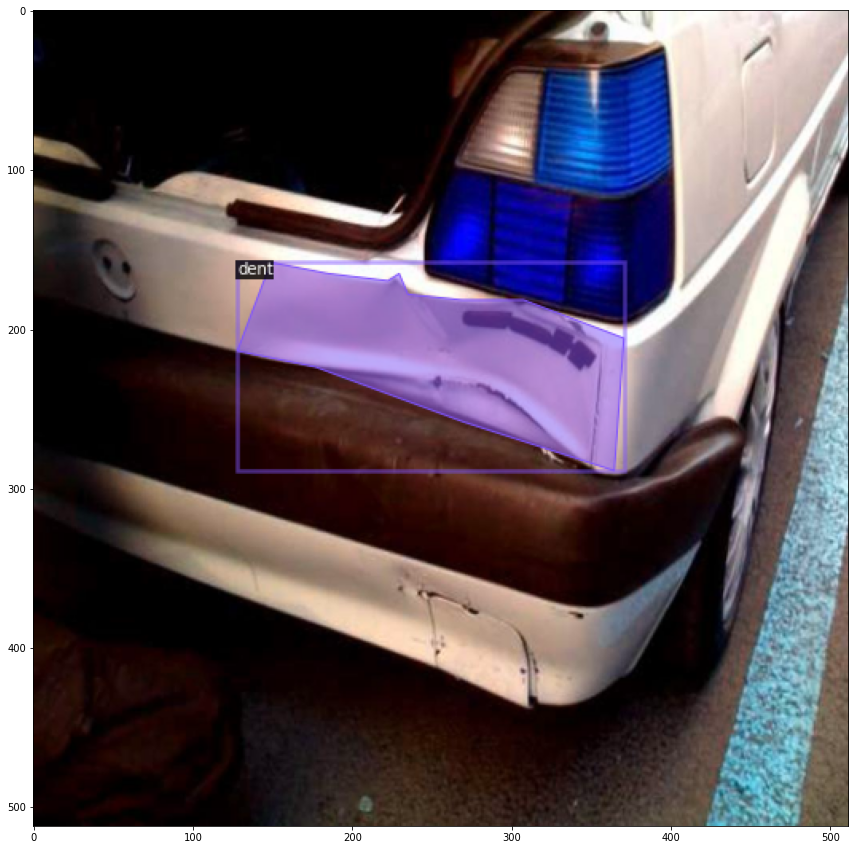

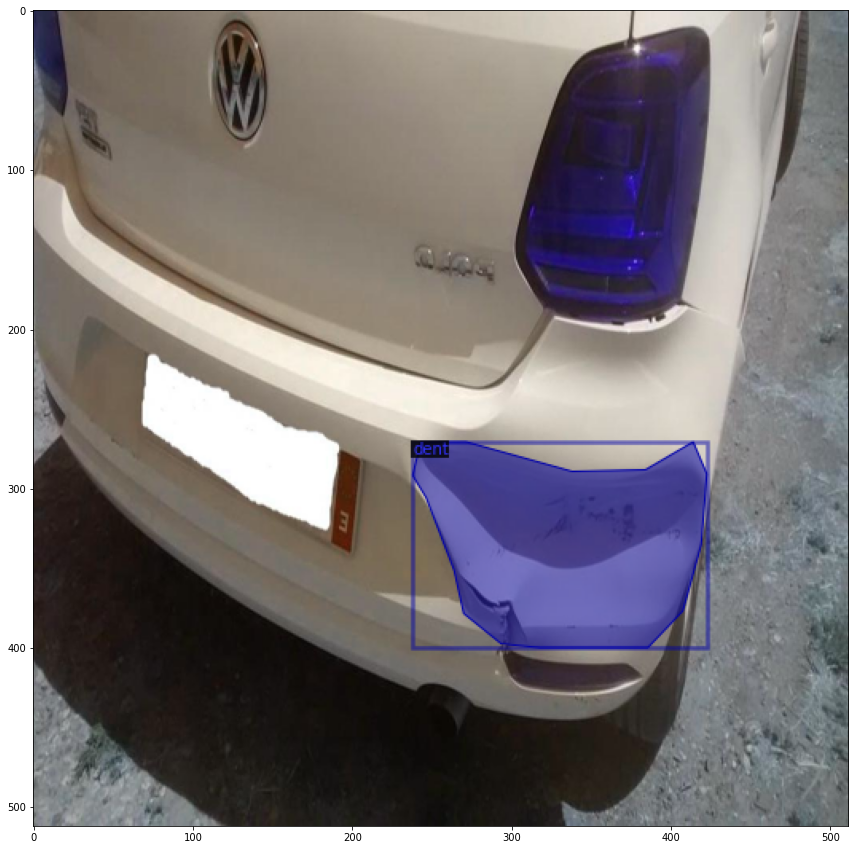

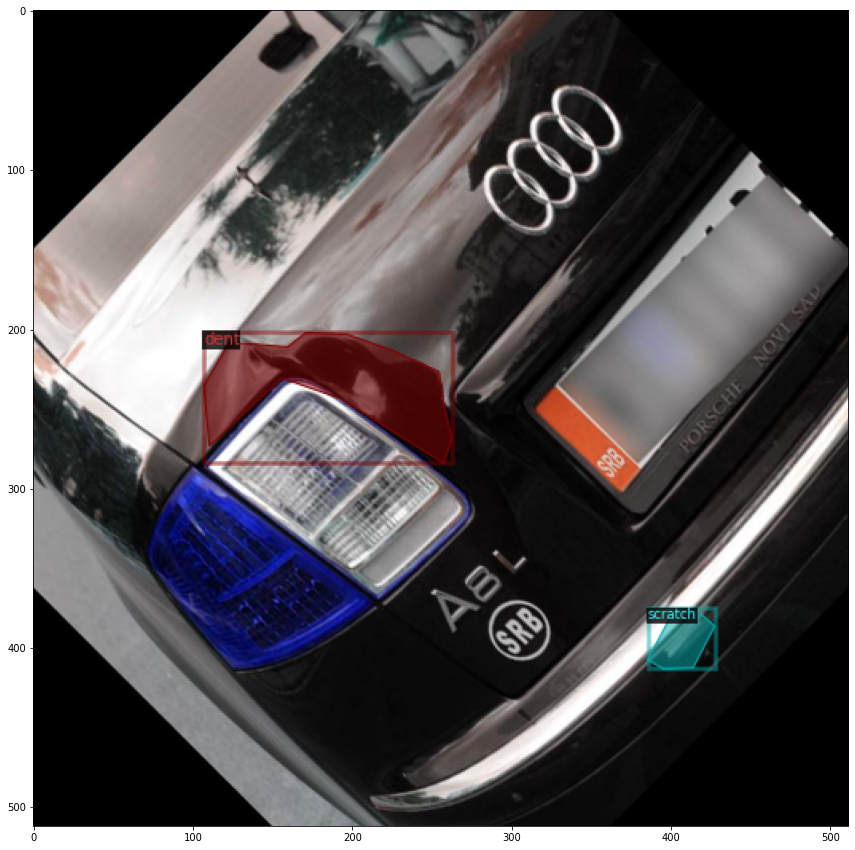

In [4]:
# Verify the data loading is correct and visualise the annotations of images
dataset_dicts = car_damage_dicts(ROOT_DIR + "dataset/" + STR_img_folder_train) # training dataset

for d in random.sample(dataset_dicts, 3): # select randomly samples in a training set
    img = cv2.imread(d["file_name"])
    visualizer = Visualizer(img[:, :, ::-1], metadata = damage_metadata, scale=0.5)
    vis = visualizer.draw_dataset_dict(d)
    plt.figure(figsize = (15,15))
    plt.imshow(vis.get_image()[:, :, ::-1])
    plt.show()

## <br><b> 2. Fine-tune Pretrained Mask R-CNN Models

### 1) COCO Mask R-CNN <b>ResNet-50 FPN 1x</b> Backbone

#### <b>[Improvement]</b> Image Augmentation during Training Time

In [ ]:
# ----------------------------------------------------------------------------------------
# Write a Custom Dataloader for Image Augmentation during Training Time
# Using a different "mapper" with build_detection_{train,test}_loader(mapper=) works 
# for most use cases of custom data loading
# ----------------------------------------------------------------------------------------
from detectron2.data import build_detection_train_loader
from detectron2.data import transforms as T
from detectron2.data import detection_utils as utils
import torch
import copy

def custom_mapper(input_dict):
    dataset_dict = copy.deepcopy(input_dict)  # it will be modified by code below
    image = utils.read_image(dataset_dict["file_name"], format="BGR")
    transform_list = [T.RandomFlip(prob=0.5, horizontal=True, vertical=False), # Random horizontal flip
                      T.RandomFlip(prob=0.5, horizontal=False, vertical=True), # Random vertical flip
                      ]
    image, transforms = T.apply_transform_gens(transform_list, image)
    dataset_dict["image"] = torch.as_tensor(image.transpose(2, 0, 1).astype("float32"))
    annos = [
        utils.transform_instance_annotations(obj, transforms, image.shape[:2])
        for obj in dataset_dict.pop("annotations")
    ]
    instances = utils.annotations_to_instances(annos, image.shape[:2])
    dataset_dict["instances"] = utils.filter_empty_instances(instances)
    # print("Data Augmentation...")
    return dataset_dict

# Use a Custom Dataloader
# In order to adopt DefaultTrainer, overwrite its build_{train,test}_loader method to use your own dataloader
# Rather than "trainer = DefaultTrainer(cfg)", use "trainer =  Trainer(cfg)"

class Trainer(DefaultTrainer):
    @classmethod
    def build_train_loader(cls, cfg):
      # Use custom_mapper, not the Default_mapper of 'DatasetMapper'
      return build_detection_train_loader(cfg, mapper = custom_mapper) 

#### <b>[Step1]</b> Train, Fine-tune a coco-pretrained Mask R-CNN model on the 'car damage' dataset



In [6]:
# Train the model
cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_1x.yaml"))
cfg.DATASETS.TRAIN = ("dataset_" + STR_img_folder_train,) # "dataset_" + image folder name
cfg.DATASETS.TEST = ()
cfg.DATALOADER.NUM_WORKERS = 0 # On Windows
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_1x.yaml")
cfg.SOLVER.IMS_PER_BATCH = 1
cfg.SOLVER.BASE_LR = 25e-5
cfg.SOLVER.MAX_ITER = 1500   # 300 iterations
cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 128   # default: 512
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 2  # two classes: class 0 - scratch, 1 - dent
os.makedirs(cfg.OUTPUT_DIR, exist_ok = True)
trainer =  Trainer(cfg)
# trainer = DefaultTrainer(cfg) 
trainer.resume_or_load(resume = False)
trainer.train()

[04/27 07:07:28 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

In [7]:
# Check training curves in tensorboard
# Before run this script, execute "cd Car_Damage", "tensorboard --logdir output" in anaconda prompt command lines
%load_ext tensorboard
%tensorboard --logdir output

Reusing TensorBoard on port 6006 (pid 1182), started 2:04:58 ago. (Use '!kill 1182' to kill it.)

<IPython.core.display.Javascript object>

#### <b>[Step2]</b> Evaluation with the Trained Model

In [8]:
# Evaluate its performance using AP metric implemented in COCO API (ex. AP of ~70%)
# Use a COCO format json file
from detectron2.evaluation import COCOEvaluator, inference_on_dataset
from detectron2.data import build_detection_test_loader

evaluator = COCOEvaluator(STR_dataset_name_coco_val, cfg, False, output_dir="output")
val_loader = build_detection_test_loader(cfg, STR_dataset_name_coco_val)
inference_on_dataset(trainer.model, val_loader, evaluator)

[04/27 07:17:29 d2.data.datasets.coco]: Loaded 63 images in COCO format from /content/gdrive/My Drive/Car_Damage/dataset/annotations/val_aug_coco_nonoise.json
[04/27 07:17:29 d2.data.build]: Distribution of instances among all 2 categories:
|  category  | #instances   |  category  | #instances   |
|:----------:|:-------------|:----------:|:-------------|
|    dent    | 102          |  scratch   | 80           |
|            |              |            |              |
|   total    | 182          |            |              |
[04/27 07:17:29 d2.data.common]: Serializing 63 elements to byte tensors and concatenating them all ...
[04/27 07:17:29 d2.data.common]: Serialized dataset takes 0.07 MiB
[04/27 07:17:29 d2.evaluation.evaluator]: Start inference on 63 images
[04/27 07:17:32 d2.evaluation.evaluator]: Inference done 11/63. 0.1173 s / img. ETA=0:00:10
[04/27 07:17:37 d2.evaluation.evaluator]: Inference done 25/63. 0.1387 s / img. ETA=0:00:11
[04/27 07:17:42 d2.evaluation.evaluator]: I

OrderedDict([('bbox',
              {'AP': 0.05497338725937383,
               'AP-dent': 0.0638125001356752,
               'AP-scratch': 0.04613427438307243,
               'AP50': 0.22667483264651014,
               'AP75': 0.014606645975334044,
               'APl': 0.06838868429568694,
               'APm': 0.9811852045826167,
               'APs': 2.3762376237623757}),
             ('segm',
              {'AP': 0.03570291479377344,
               'AP-dent': 0.020912996802407366,
               'AP-scratch': 0.05049283278513952,
               'AP50': 0.1267910743052499,
               'AP75': 0.0,
               'APl': 0.1849070620146947,
               'APm': 0.1564975192674172,
               'APs': 0.39603960396039606})])

#### <b>[Step3]</b> Inference - Randomly select samples to visualize the prediction results

In [9]:
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
print(cfg.MODEL.WEIGHTS)
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5   # set the testing threshold for this model
cfg.DATASETS.TEST = (STR_dataset_name_val, )
predictor = DefaultPredictor(cfg)

./output/model_final.pth


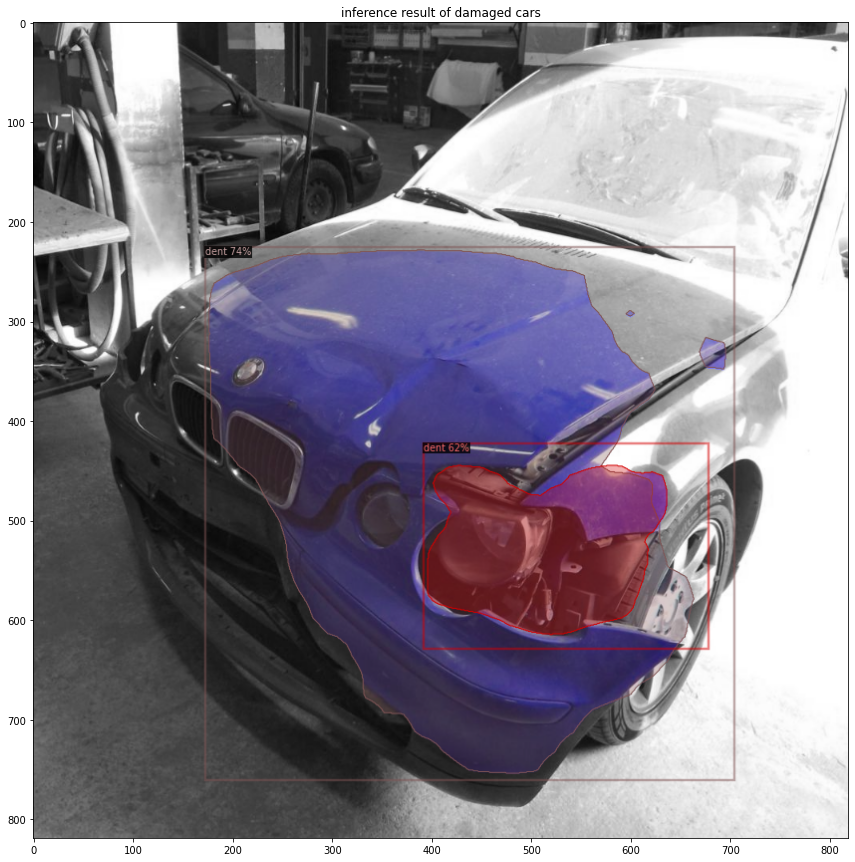

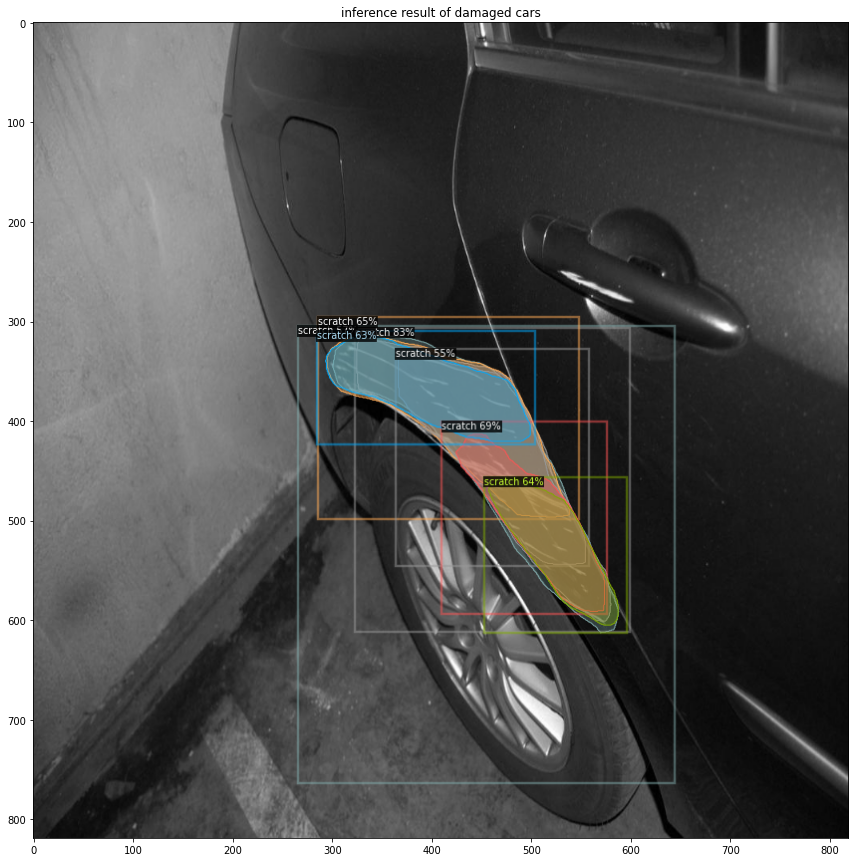

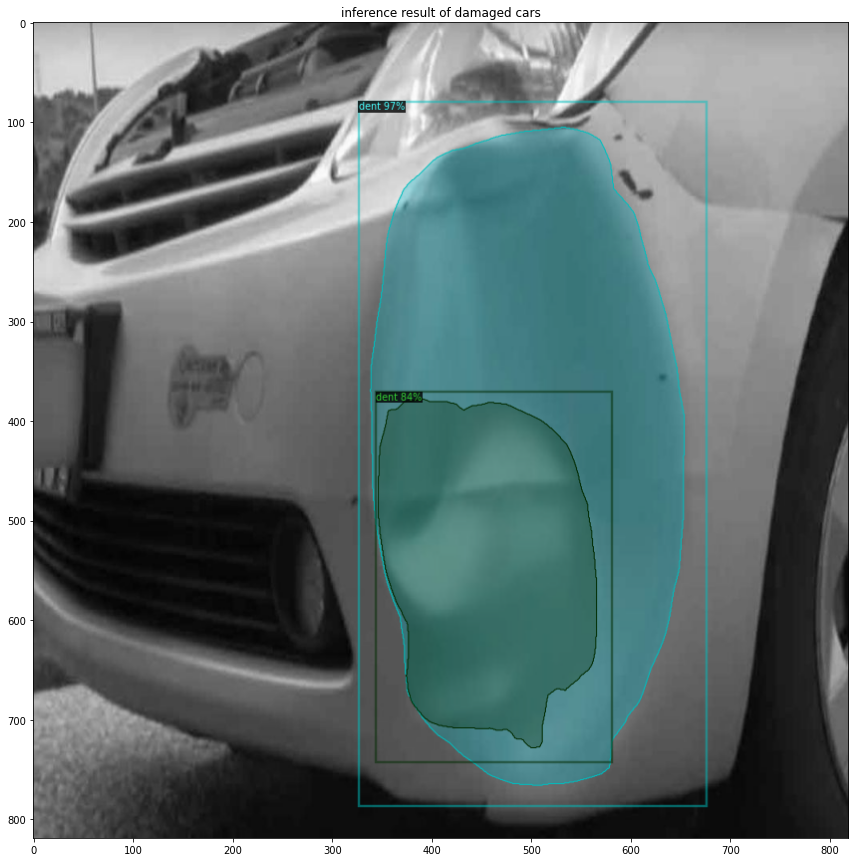

In [10]:
from detectron2.utils.visualizer import ColorMode
dataset_dicts = car_damage_dicts(ROOT_DIR + "dataset/" + STR_img_folder_val)
for d in random.sample(dataset_dicts, 3):    
    im = cv2.imread(d["file_name"])
    outputs = predictor(im)
    v = Visualizer(im[:, :, ::-1],
                   metadata=damage_metadata, 
                   scale=0.8, 
                   instance_mode=ColorMode.IMAGE_BW   # remove the colors of unsegmented pixels
    )
    v = v.draw_instance_predictions(outputs["instances"].to("cpu"))
  
    plt.figure(figsize=(15,15))
    plt.imshow(v.get_image()[:, :, ::-1])
    plt.title('inference result of damaged cars')
    plt.show()

In [11]:
# Throughput performance
import time
times = []
for i in range(20):
    start_time = time.time()
    outputs = predictor(im)
    delta = time.time() - start_time
    times.append(delta)
mean_delta = np.array(times).mean()
fps = 1 / mean_delta
print("Average(sec):{:.2f},fps:{:.2f}".format(mean_delta, fps))

Average(sec):0.13,fps:7.59


---------------------------------------------------------------------------------------------------------------------------------------------------------
### 2) COCO Mask R-CNN <b>ResNet-50 FPN 3x</b> Backbone

#### <b>[Step1]</b> Train, Fine-tune a coco-pretrained Mask R-CNN model on the 'car damage' dataset

In [12]:
# Train the model
cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml"))
cfg.DATASETS.TRAIN = ("dataset_" + STR_img_folder_train,)
cfg.DATASETS.TEST = ()
cfg.DATALOADER.NUM_WORKERS = 0 # On Windows
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml")
cfg.SOLVER.IMS_PER_BATCH = 1
cfg.SOLVER.BASE_LR = 25e-5
cfg.SOLVER.MAX_ITER = 1500    # 300 iterations
cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 128   # default: 512
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 2  # two classes: class 0 - scratch, 1 - dent

os.makedirs(cfg.OUTPUT_DIR, exist_ok = True)
trainer =  Trainer(cfg)
# trainer = DefaultTrainer(cfg) 
trainer.resume_or_load(resume = False)
trainer.train()

[04/27 07:17:55 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

model_final_f10217.pkl: 178MB [00:02, 62.9MB/s]                           


[04/27 07:18:05 d2.engine.train_loop]: Starting training from iteration 0
[04/27 07:18:13 d2.utils.events]:  eta: 0:09:25  iter: 19  total_loss: 2.414  loss_cls: 1.118  loss_box_reg: 0.474  loss_mask: 0.692  loss_rpn_cls: 0.025  loss_rpn_loc: 0.025  time: 0.3856  data_time: 0.0721  lr: 0.000005  max_mem: 1785M
[04/27 07:18:20 d2.utils.events]:  eta: 0:09:22  iter: 39  total_loss: 2.215  loss_cls: 1.016  loss_box_reg: 0.474  loss_mask: 0.692  loss_rpn_cls: 0.010  loss_rpn_loc: 0.014  time: 0.3869  data_time: 0.0666  lr: 0.000010  max_mem: 1785M
[04/27 07:18:28 d2.utils.events]:  eta: 0:09:15  iter: 59  total_loss: 2.285  loss_cls: 0.905  loss_box_reg: 0.614  loss_mask: 0.689  loss_rpn_cls: 0.041  loss_rpn_loc: 0.020  time: 0.3884  data_time: 0.0825  lr: 0.000015  max_mem: 1785M
[04/27 07:18:36 d2.utils.events]:  eta: 0:09:09  iter: 79  total_loss: 1.889  loss_cls: 0.751  loss_box_reg: 0.474  loss_mask: 0.688  loss_rpn_cls: 0.031  loss_rpn_loc: 0.021  time: 0.3888  data_time: 0.0832  lr:

In [13]:
# Check training curves in tensorboard
# Before run this script, execute "cd Car_Damage", "tensorboard --logdir output" in anaconda prompt command lines
%load_ext tensorboard
%tensorboard --logdir output

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


Reusing TensorBoard on port 6006 (pid 1182), started 2:15:31 ago. (Use '!kill 1182' to kill it.)

<IPython.core.display.Javascript object>

#### <b>[Step2]</b> Evaluation with the Trained Model

In [14]:
# Evaluate its performance using AP metric implemented in COCO API (ex. AP of ~70%)
from detectron2.evaluation import COCOEvaluator, inference_on_dataset
from detectron2.data import build_detection_test_loader

evaluator = COCOEvaluator(STR_dataset_name_coco_val, cfg, False, output_dir="output")
val_loader = build_detection_test_loader(cfg, STR_dataset_name_coco_val)
inference_on_dataset(trainer.model, val_loader, evaluator)

[04/27 07:28:03 d2.data.datasets.coco]: Loaded 63 images in COCO format from /content/gdrive/My Drive/Car_Damage/dataset/annotations/val_aug_coco_nonoise.json
[04/27 07:28:03 d2.data.common]: Serializing 63 elements to byte tensors and concatenating them all ...
[04/27 07:28:03 d2.data.common]: Serialized dataset takes 0.07 MiB
[04/27 07:28:03 d2.evaluation.evaluator]: Start inference on 63 images
[04/27 07:28:05 d2.evaluation.evaluator]: Inference done 11/63. 0.1130 s / img. ETA=0:00:09
[04/27 07:28:10 d2.evaluation.evaluator]: Inference done 33/63. 0.1206 s / img. ETA=0:00:06
[04/27 07:28:15 d2.evaluation.evaluator]: Inference done 56/63. 0.1198 s / img. ETA=0:00:01
[04/27 07:28:16 d2.evaluation.evaluator]: Total inference time: 0:00:12.853024 (0.221604 s / img per device, on 1 devices)
[04/27 07:28:16 d2.evaluation.evaluator]: Total inference pure compute time: 0:00:06 (0.120324 s / img per device, on 1 devices)
[04/27 07:28:16 d2.evaluation.coco_evaluation]: Preparing results for C

OrderedDict([('bbox',
              {'AP': 0.17568365951081424,
               'AP-dent': 0.2782932673511878,
               'AP-scratch': 0.07307405167044073,
               'AP50': 0.5099248119137685,
               'AP75': 0.050631706283118055,
               'APl': 0.4825101385184258,
               'APm': 0.6446012844527697,
               'APs': 0.0}),
             ('segm',
              {'AP': 0.07704499142579058,
               'AP-dent': 0.08230529271158603,
               'AP-scratch': 0.07178469013999511,
               'AP50': 0.23718679356799285,
               'AP75': 0.023762376237623763,
               'APl': 0.3972214270769295,
               'APm': 0.16495444640465026,
               'APs': 0.0})])

#### <b>[Step3]</b> Inference - Randomly select samples to visualize the prediction results

In [15]:
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
print(cfg.MODEL.WEIGHTS)
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5   # set the testing threshold for this model
cfg.DATASETS.TEST = (STR_dataset_name_val, )
predictor = DefaultPredictor(cfg)

./output/model_final.pth


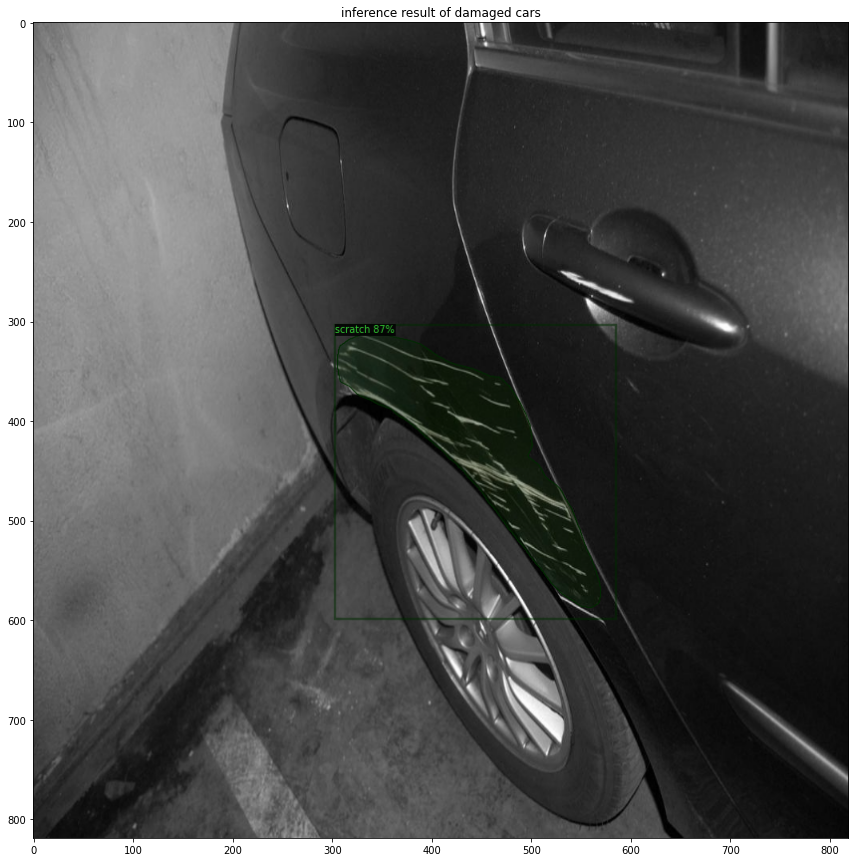

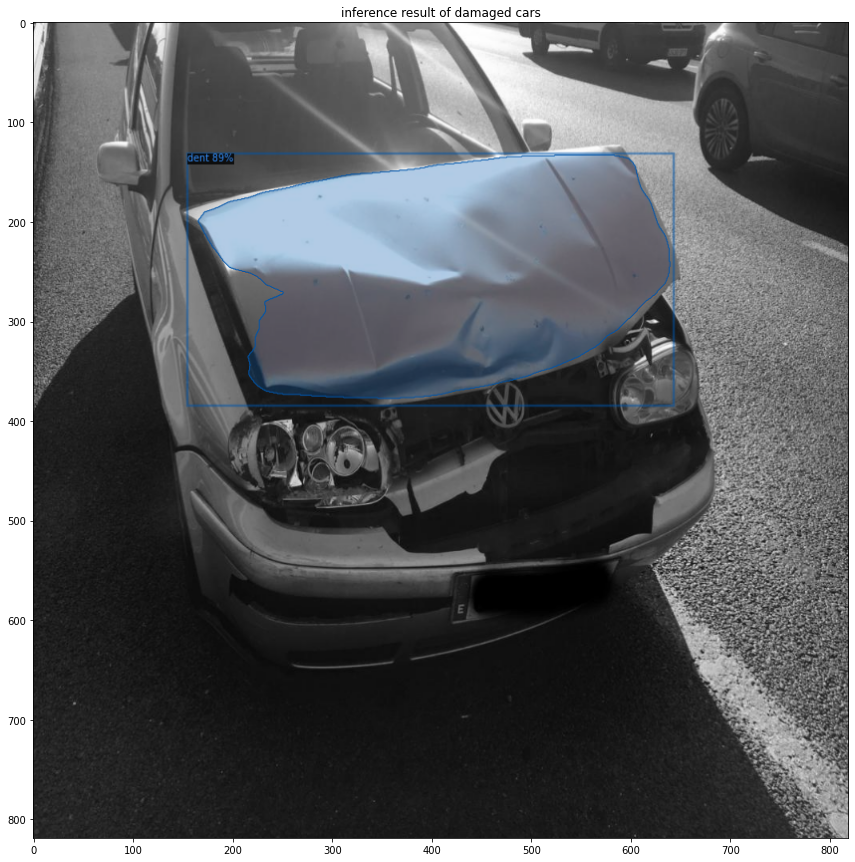

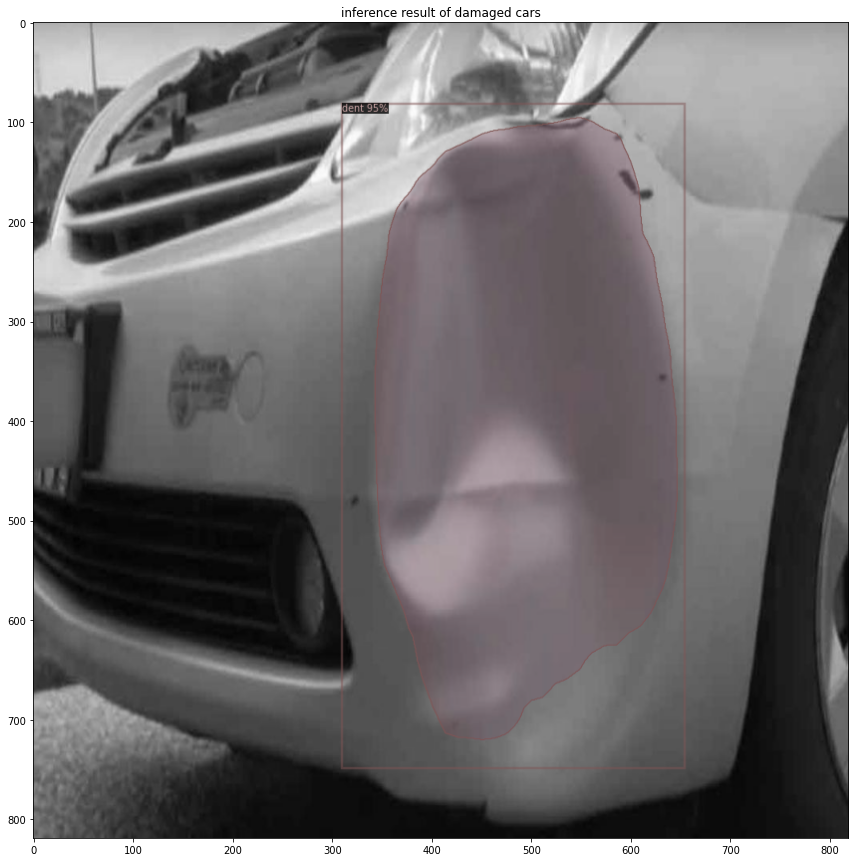

In [16]:
from detectron2.utils.visualizer import ColorMode
dataset_dicts = car_damage_dicts(ROOT_DIR + "dataset/" + STR_img_folder_val)
for d in random.sample(dataset_dicts, 3):    
    im = cv2.imread(d["file_name"])
    outputs = predictor(im)
    v = Visualizer(im[:, :, ::-1],
                   metadata=damage_metadata, 
                   scale=0.8, 
                   instance_mode=ColorMode.IMAGE_BW   # remove the colors of unsegmented pixels
    )
    v = v.draw_instance_predictions(outputs["instances"].to("cpu"))
  
    plt.figure(figsize=(15,15))
    plt.imshow(v.get_image()[:, :, ::-1])
    plt.title('inference result of damaged cars')
    plt.show()

In [17]:
from google.colab import drive
drive.mount('/content/gdrive')

Drive already mounted at /content/gdrive; to attempt to forcibly remount, call drive.mount("/content/gdrive", force_remount=True).


In [18]:
# Throughput performance
import time
times = []
for i in range(20):
    start_time = time.time()
    outputs = predictor(im)
    delta = time.time() - start_time
    times.append(delta)
mean_delta = np.array(times).mean()
fps = 1 / mean_delta
print("Average(sec):{:.2f},fps:{:.2f}".format(mean_delta, fps))

Average(sec):0.13,fps:7.56


---------------------------------------------------------------------------------------------------------------------------------------------------------
### 3) COCO Mask R-CNN <b>ResNet-101 FPN 3x</b> Backbone

#### <b>[Step1]</b> Train, Fine-tune a coco-pretrained Mask R-CNN model on the 'car damage' dataset

In [19]:
# Train the model
cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-InstanceSegmentation/mask_rcnn_R_101_FPN_3x.yaml"))
cfg.DATASETS.TRAIN = ("dataset_" + STR_img_folder_train,)
cfg.DATASETS.TEST = ()
cfg.DATALOADER.NUM_WORKERS = 0 # On Windows
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-InstanceSegmentation/mask_rcnn_R_101_FPN_3x.yaml")
cfg.SOLVER.IMS_PER_BATCH = 1
cfg.SOLVER.BASE_LR = 25e-5
cfg.SOLVER.MAX_ITER = 1500    # 300 iterations
cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 128   # default: 512
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 2  # two classes: class 0 - scratch, 1 - dent

os.makedirs(cfg.OUTPUT_DIR, exist_ok = True)
trainer =  Trainer(cfg)
# trainer = DefaultTrainer(cfg) 
trainer.resume_or_load(resume = False)
trainer.train()

[04/27 07:28:24 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

model_final_a3ec72.pkl: 254MB [00:04, 62.3MB/s]                           


[04/27 07:28:35 d2.engine.train_loop]: Starting training from iteration 0
[04/27 07:28:46 d2.utils.events]:  eta: 0:13:28  iter: 19  total_loss: 2.111  loss_cls: 0.902  loss_box_reg: 0.344  loss_mask: 0.691  loss_rpn_cls: 0.037  loss_rpn_loc: 0.016  time: 0.5515  data_time: 0.0834  lr: 0.000005  max_mem: 2412M
[04/27 07:28:57 d2.utils.events]:  eta: 0:13:32  iter: 39  total_loss: 2.234  loss_cls: 0.868  loss_box_reg: 0.591  loss_mask: 0.692  loss_rpn_cls: 0.038  loss_rpn_loc: 0.025  time: 0.5529  data_time: 0.0885  lr: 0.000010  max_mem: 2412M
[04/27 07:29:08 d2.utils.events]:  eta: 0:13:19  iter: 59  total_loss: 2.029  loss_cls: 0.739  loss_box_reg: 0.565  loss_mask: 0.689  loss_rpn_cls: 0.031  loss_rpn_loc: 0.017  time: 0.5534  data_time: 0.0882  lr: 0.000015  max_mem: 2412M
[04/27 07:29:19 d2.utils.events]:  eta: 0:13:09  iter: 79  total_loss: 1.862  loss_cls: 0.613  loss_box_reg: 0.409  loss_mask: 0.687  loss_rpn_cls: 0.040  loss_rpn_loc: 0.021  time: 0.5541  data_time: 0.0921  lr:

In [20]:
# Check training curves in tensorboard
# Before run this script, execute "cd Car_Damage", "tensorboard --logdir output" in anaconda prompt command lines
%load_ext tensorboard
%tensorboard --logdir output

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


Reusing TensorBoard on port 6006 (pid 1182), started 2:30:08 ago. (Use '!kill 1182' to kill it.)

<IPython.core.display.Javascript object>

#### <b>[Step2]</b> Evaluation with the Trained Model

In [21]:
# Evaluate its performance using AP metric implemented in COCO API (ex. AP of ~70%)
from detectron2.evaluation import COCOEvaluator, inference_on_dataset
from detectron2.data import build_detection_test_loader

evaluator = COCOEvaluator(STR_dataset_name_coco_val, cfg, False, output_dir="output")
val_loader = build_detection_test_loader(cfg, STR_dataset_name_coco_val)
inference_on_dataset(trainer.model, val_loader, evaluator)

[04/27 07:42:39 d2.data.datasets.coco]: Loaded 63 images in COCO format from /content/gdrive/My Drive/Car_Damage/dataset/annotations/val_aug_coco_nonoise.json
[04/27 07:42:39 d2.data.common]: Serializing 63 elements to byte tensors and concatenating them all ...
[04/27 07:42:39 d2.data.common]: Serialized dataset takes 0.07 MiB
[04/27 07:42:39 d2.evaluation.evaluator]: Start inference on 63 images
[04/27 07:42:42 d2.evaluation.evaluator]: Inference done 11/63. 0.1509 s / img. ETA=0:00:11
[04/27 07:42:47 d2.evaluation.evaluator]: Inference done 29/63. 0.1555 s / img. ETA=0:00:09
[04/27 07:42:52 d2.evaluation.evaluator]: Inference done 50/63. 0.1542 s / img. ETA=0:00:03
[04/27 07:42:55 d2.evaluation.evaluator]: Total inference time: 0:00:14.635254 (0.252332 s / img per device, on 1 devices)
[04/27 07:42:55 d2.evaluation.evaluator]: Total inference pure compute time: 0:00:08 (0.152313 s / img per device, on 1 devices)
[04/27 07:42:55 d2.evaluation.coco_evaluation]: Preparing results for C

OrderedDict([('bbox',
              {'AP': 0.2513009928931415,
               'AP-dent': 0.2811533366567445,
               'AP-scratch': 0.22144864912953843,
               'AP50': 0.760991726377173,
               'AP75': 0.1102953532460653,
               'APl': 0.7066262248070633,
               'APm': 4.042641764176417,
               'APs': 2.3762376237623757}),
             ('segm',
              {'AP': 0.12960243829236803,
               'AP-dent': 0.03126628452318916,
               'AP-scratch': 0.22793859206154693,
               'AP50': 0.3822427977270484,
               'AP75': 0.0602447921300474,
               'APl': 0.9724932737448714,
               'APm': 0.4223153084539223,
               'APs': 1.5841584158415838})])

#### <b>[Step3]</b> Inference - Randomly select samples to visualize the prediction results

In [22]:
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
print(cfg.MODEL.WEIGHTS)
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5   # set the testing threshold for this model
cfg.DATASETS.TEST = (STR_dataset_name_val, )
predictor = DefaultPredictor(cfg)

./output/model_final.pth


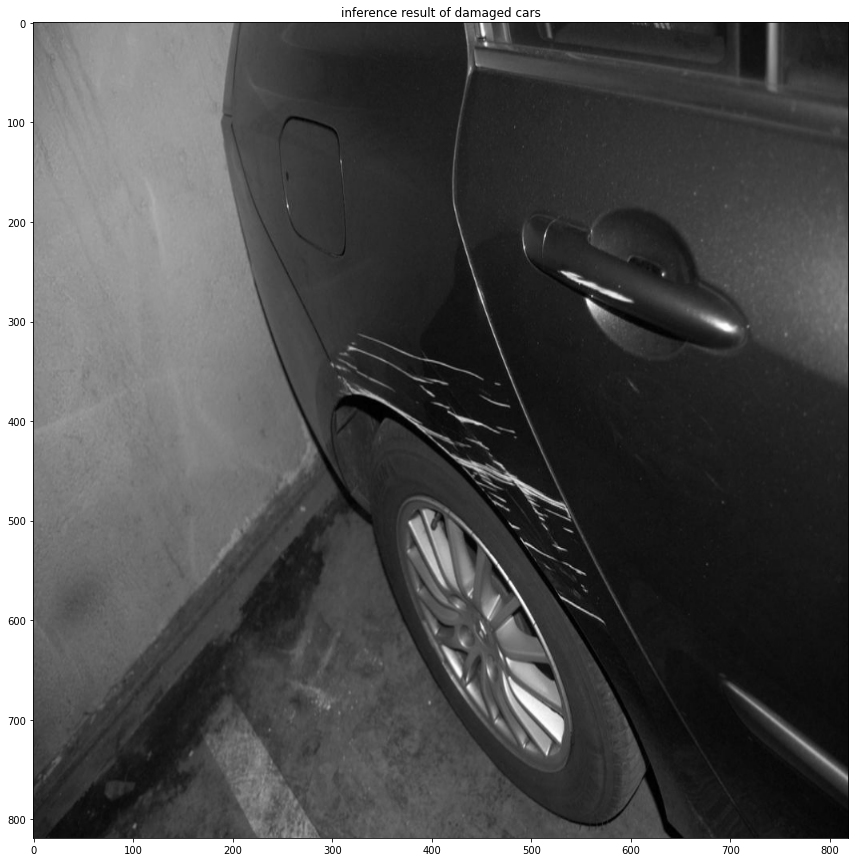

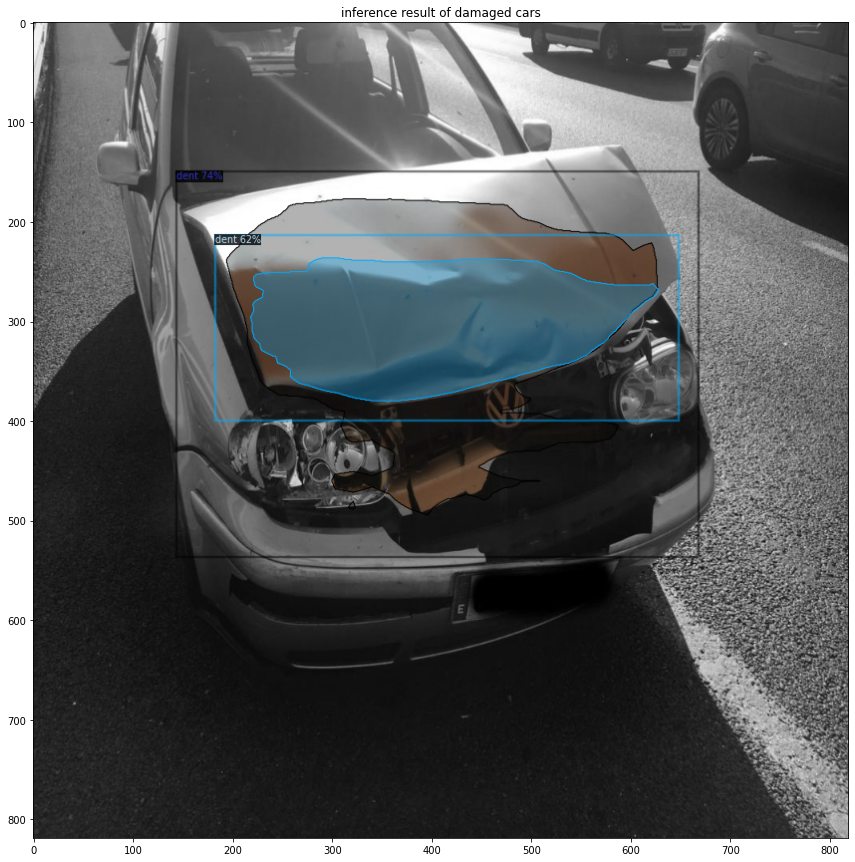

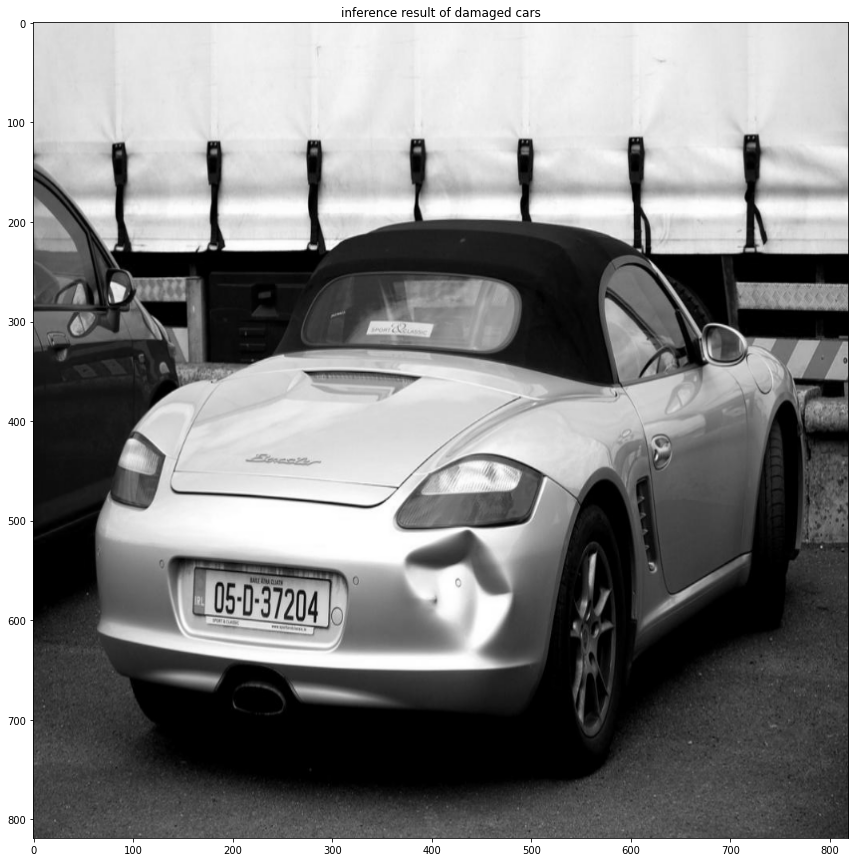

In [23]:
from detectron2.utils.visualizer import ColorMode
dataset_dicts = car_damage_dicts(ROOT_DIR + "dataset/" + STR_img_folder_val)
for d in random.sample(dataset_dicts, 3):    
    im = cv2.imread(d["file_name"])
    outputs = predictor(im)
    v = Visualizer(im[:, :, ::-1],
                   metadata=damage_metadata, 
                   scale=0.8, 
                   instance_mode=ColorMode.IMAGE_BW   # remove the colors of unsegmented pixels
    )
    v = v.draw_instance_predictions(outputs["instances"].to("cpu"))
  
    plt.figure(figsize=(15,15))
    plt.imshow(v.get_image()[:, :, ::-1])
    plt.title('inference result of damaged cars')
    plt.show()

In [24]:
# Throughput performance
import time
times = []
for i in range(20):
    start_time = time.time()
    outputs = predictor(im)
    delta = time.time() - start_time
    times.append(delta)
mean_delta = np.array(times).mean()
fps = 1 / mean_delta
print("Average(sec):{:.2f},fps:{:.2f}".format(mean_delta, fps))

Average(sec):0.16,fps:6.18


## <br><b>References

Detectron2 contributors Revision, (2020). Detectron2 Beginner's Tutorial [online]. Google Colab.<br> [Viewed 15 March 2020]. Available from: https://colab.research.google.com/drive/16jcaJoc6bCFAQ96jDe2HwtXj7BMD_-m5<br>

Detectron2 contributors Revision, (2020). Use Custom Dataloaders [online]. Detectron2 Docs Tutorials.<br> [Viewed 15 March 2020]. Available from: https://detectron2.readthedocs.io/tutorials/data_loading.html<br>

facebookresearch/detectron2, (2020). Use Custom Dataloaders [online]. GitHub.<br> [Viewed 23 April 2020]. Available from: https://github.com/facebookresearch/detectron2/blob/master/docs/tutorials/data_loading.md<br>

facebookresearch/detectron2, (2020). Verify Image Augmentation in Training Set #791 [online]. GitHub.<br> [Viewed 23 April 2020]. Available from: https://github.com/facebookresearch/detectron2/issues/791<br>


-------------------------------------------------------------------------------

## <b>Set-up Environment for Development</b>


In [25]:
# install dependencies: (use cu101 because colab has CUDA 10.1)
!pip install -U torch==1.4 torchvision==0.5 -f https://download.pytorch.org/whl/cu101/torch_stable.html 
!pip install cython pyyaml==5.1
!pip install -U 'git+https://github.com/cocodataset/cocoapi.git#subdirectory=PythonAPI'
import torch, torchvision
print(torch.__version__, torch.cuda.is_available())
!gcc --version
# opencv is pre-installed on colab

Looking in links: https://download.pytorch.org/whl/cu101/torch_stable.html
Requirement already up-to-date: torch==1.4 in /usr/local/lib/python3.6/dist-packages (1.4.0)
Requirement already up-to-date: torchvision==0.5 in /usr/local/lib/python3.6/dist-packages (0.5.0)
  Cloning https://github.com/cocodataset/cocoapi.git to /tmp/pip-req-build-xyzo1qj6
  Running command git clone -q https://github.com/cocodataset/cocoapi.git /tmp/pip-req-build-xyzo1qj6
  Created wheel for pycocotools: filename=pycocotools-2.0-cp36-cp36m-linux_x86_64.whl size=275315 sha256=a8e82fa1f1777564850009a7745de9f1306353d2ad9d6b6253db14dcdb86cd0c
  Stored in directory: /tmp/pip-ephem-wheel-cache-h2vx179h/wheels/90/51/41/646daf401c3bc408ff10de34ec76587a9b3ebfac8d21ca5c3a
Successfully built pycocotools
  Found existing installation: pycocotools 2.0
    Uninstalling pycocotools-2.0:
      Successfully uninstalled pycocotools-2.0


1.4.0 True
gcc (Ubuntu 7.5.0-3ubuntu1~18.04) 7.5.0
Copyright (C) 2017 Free Software Foundation, Inc.
This is free software; see the source for copying conditions.  There is NO
warranty; not even for MERCHANTABILITY or FITNESS FOR A PARTICULAR PURPOSE.



In [26]:
# install detectron2:
!pip install detectron2 -f https://dl.fbaipublicfiles.com/detectron2/wheels/cu101/index.html

# You may need to restart your runtime prior to this, to let your installation take effect

Looking in links: https://dl.fbaipublicfiles.com/detectron2/wheels/cu101/index.html


In [27]:
!ls

gdrive	output	sample_data


In [28]:
from google.colab import drive 
drive.mount('/content/gdrive/')

Drive already mounted at /content/gdrive/; to attempt to forcibly remount, call drive.mount("/content/gdrive/", force_remount=True).
